# Permanent magnet assembly B-field simulation

## Ruster coil implementations

Composed of individual cylindrical permanent magnets arranged along the circumference of structural coil.

**Note that trying to reproduce the layout from Ruster, 2016, does not give the expected B-field reading at the ion position. Stated in paper: 0.37mT = 3.7G, simulation gives 0.548G at central position.**

Collection
├── Collection
│   └── 40x Cylinders
└── Collection
    └── 40x Cylinders
Maximum B-field along +z direction: 3.605 G
Central B-field along +z axis: 0.548 G
Maximum B-field along +x direction: 0.548 G
Central B-field along +x axis: 0.548 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:0.004060179055256234
Min axial nonuniformity: 0.0
Max axial nonuniformity:0.006038355803919769


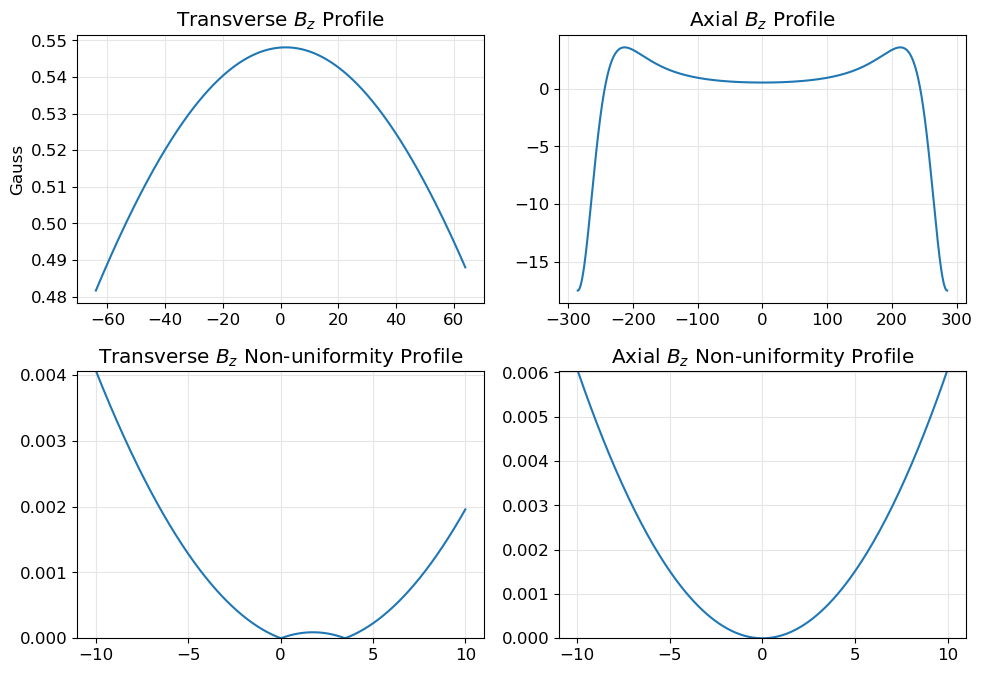

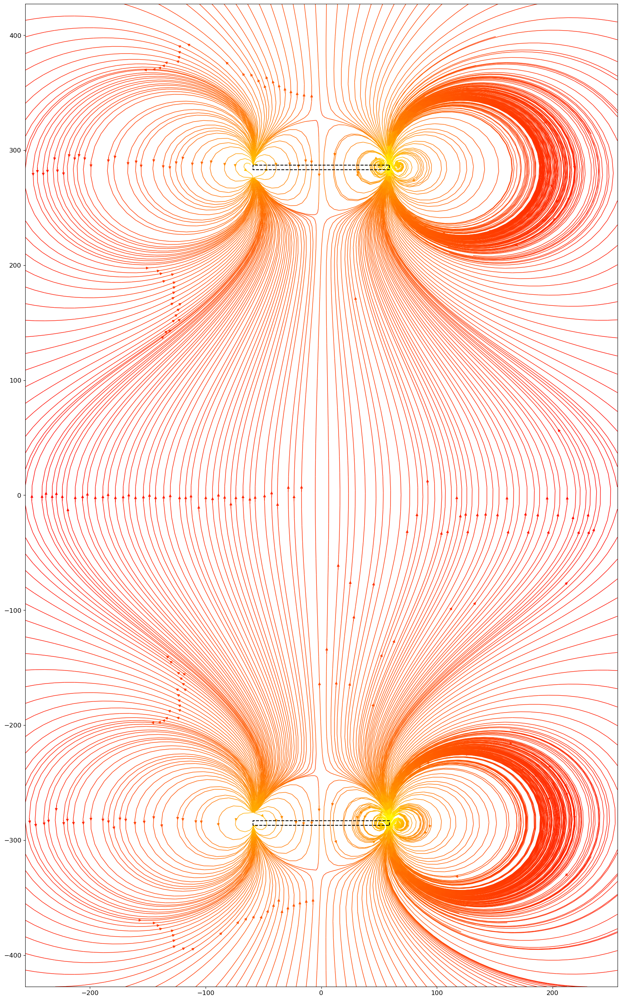

In [1]:
import numpy as np
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream
from maggeometry import cyl_ring
import magpylib as magpy
from magpylib.magnet import Cylinder, CylinderSegment


# dimensions of each individual cylinder
c_diameter = 6
c_rad = c_diameter/2
c_height = 4
Br = (0, 0, 1.0e3) # in mT

# dimensions of structural coil
st_inner_diameter = 108
st_outer_diameter = 128
st_inner_rad = st_inner_diameter/2
st_outer_rad = st_outer_diameter/2
st_mid_rad = (st_inner_rad + st_outer_rad)/2
magnets_per_coil = 40
# distance from ion
dist = 285
# dist = np.s

magnet_assembly = magpy.Collection()
mag_top = cyl_ring(magnets_per_coil, Br, c_diameter, c_height, st_mid_rad, +dist, False)
mag_bottom = cyl_ring(magnets_per_coil, Br, c_diameter, c_height, st_mid_rad, -dist, False)
magnet_assembly.add(mag_top).add(mag_bottom)
# magpy.show(magnet_assembly, style_magnetization_show=True)
magnet_assembly.describe(format='label')
# print([s.style.label for s in magnet_assembly.children_all])

get_field_on_axes(magnet_assembly, 2*dist, st_outer_diameter, [-10, 10], [-10, 10])

x_bounds = [-2*st_outer_diameter, 2*st_outer_diameter]
z_bounds = [-1.5*dist, 1.5*dist]
nearsurface_z =  dist - c_height/2
farsurface_z = dist + c_height/2

cross_section_magnets = np.array([
    [[st_mid_rad,st_mid_rad,-st_mid_rad,-st_mid_rad,st_mid_rad], [farsurface_z,nearsurface_z,nearsurface_z,farsurface_z,farsurface_z]],
    [[st_mid_rad,st_mid_rad,-st_mid_rad,-st_mid_rad,st_mid_rad], [-farsurface_z,-nearsurface_z,-nearsurface_z,-farsurface_z,-farsurface_z]],
])
make_flux_stream(magnet_assembly, x_bounds, z_bounds, cross_section_magnets)


## Malinowski implementation

- 52 cylindrical permanent magnets on structural coil
- ion-coil spacing 142mm

**Paper states: 4.25G at ion.**

**Using equation from paper: 2.559G at ion**

**Simulation obtains: 2.548G at ion.**

$B_0 = \frac{NB_rV}{d^3}\frac{2-\eta^2}{2\pi(1+\eta^2)^{5/2}}$

In [19]:
import numpy as np
N = 52
br = 1
mm = 1e-3
rad = 3 * mm
height = 4 * mm
eta = 0.59
V = np.pi * rad**2 * height
d = 142 * mm
TtoG = 1e4

b0 = N*br*V * (2-eta**2) / (d**3 * 2*np.pi * (1+eta**2)**(5/2))
print(b0 * TtoG)

2.5591120220731707


Collection
├── Collection
│   └── 52x Cylinders
└── Collection
    └── 52x Cylinders
Maximum B-field along +z direction: 2.548 G
Central B-field along +z axis: 2.548 G
Maximum B-field along +x direction: 2.573 G
Central B-field along +x axis: 2.548 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:0.0041291137932372
Min axial nonuniformity: 0.0
Max axial nonuniformity:0.00019609702843225024


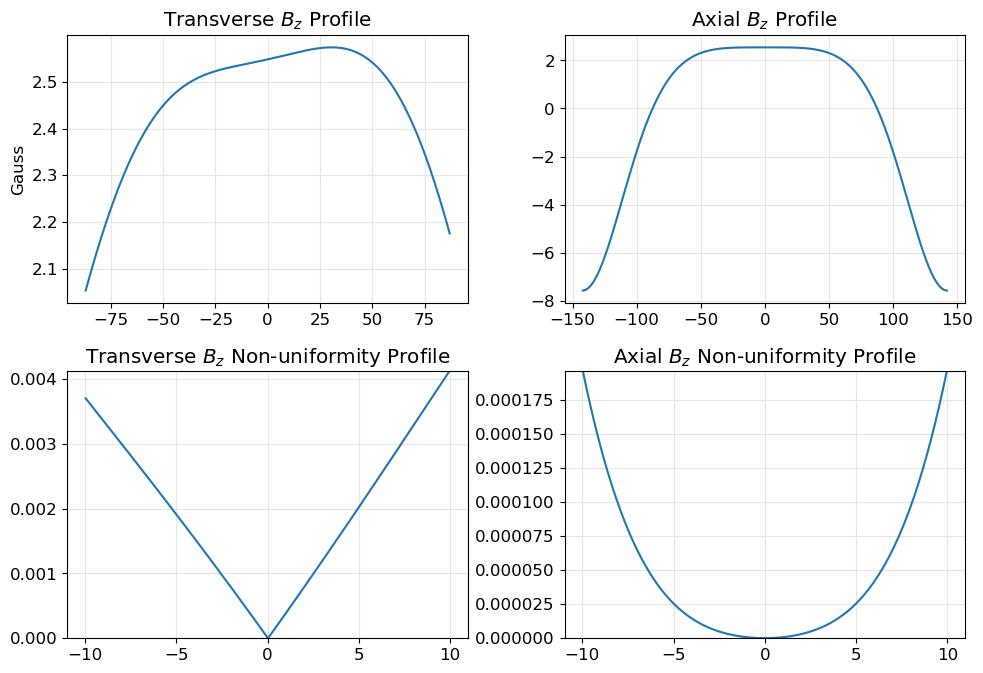

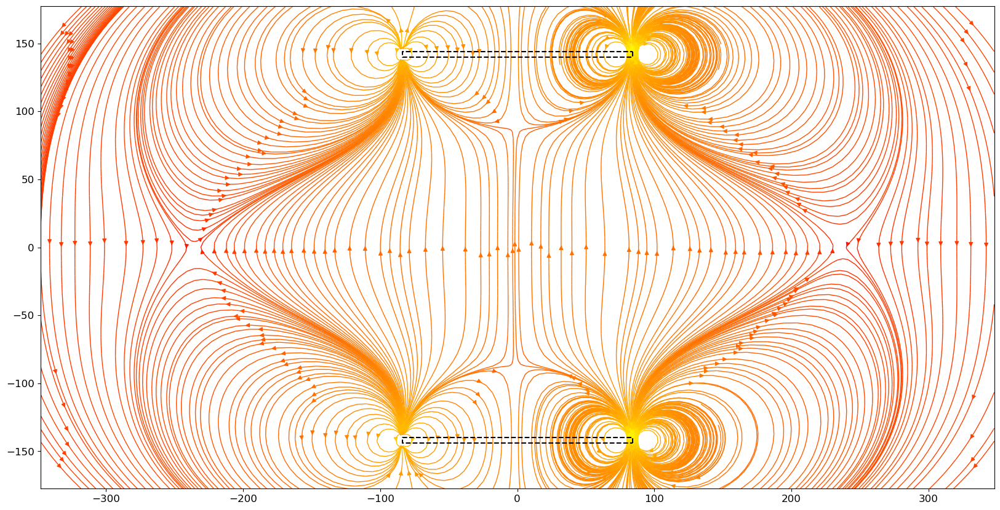

In [2]:
import numpy as np
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream
import magpylib as magpy
from magpylib.magnet import CylinderSegment

# dimensions of each individual cylinder
c_diameter = 6
c_rad = c_diameter/2
c_height = 4
Br = (0, 0, 1.0e3) # in mT

# dimensions of structural coil
st_mid_rad = 84
st_mid_diameter = 2*st_mid_rad
st_inner_diameter = st_mid_diameter - c_diameter
st_outer_diameter = st_mid_diameter + c_diameter
st_inner_rad = st_inner_diameter/2
st_outer_rad = st_outer_diameter/2
magnets_per_coil = 52
# distance from ion
dist = 142

magnet_assembly = magpy.Collection()
mag_top = cyl_ring(magnets_per_coil, Br, c_diameter, c_height, st_mid_rad, +dist)
mag_bottom = cyl_ring(magnets_per_coil, Br, c_diameter, c_height, st_mid_rad, -dist)

magnet_assembly.add(mag_top).add(mag_bottom)
magnet_assembly.describe(format='label')
# magpy.show(magnet_assembly, style_magnetization_show=True)

get_field_on_axes(magnet_assembly, 2*(dist), st_outer_diameter, [-10, 10], [-10, 10])

x_bounds = [-2*st_outer_diameter, 2*st_outer_diameter]
z_bounds = [-1.25*dist, 1.25*dist]
nearsurface_z =  dist - c_height/2
farsurface_z = dist + c_height/2

cross_section_magnets = np.array([
    [[st_mid_rad,st_mid_rad,-st_mid_rad,-st_mid_rad,st_mid_rad], [farsurface_z,nearsurface_z,nearsurface_z,farsurface_z,farsurface_z]],
    [[st_mid_rad,st_mid_rad,-st_mid_rad,-st_mid_rad,st_mid_rad], [-farsurface_z,-nearsurface_z,-nearsurface_z,-farsurface_z,-farsurface_z]],
])
make_flux_stream(magnet_assembly, x_bounds, z_bounds, cross_section_magnets)
